In [1]:
using FITSIO
using DataFrames, CSV

using GLMakie
using Measurements
#using KernelDensity

import SciPy
using QuadGK

import LinearAlgebra: diag

import LilGuys as lguys
using Arya

using JSON

# Setup functions and codes

In [2]:
inch = 72 # points

72

In [3]:
function is_point_in_polygon(point, polygon)
    x, y = point
    inside = false
    N = size(polygon, 2)  # Number of vertices in the polygon
    j = N  # Start with the last vertex
    for i in 1:N
        xi, yi = polygon[1, i], polygon[2, i]
        xj, yj = polygon[1, j], polygon[2, j]
        
        # Check if point intersects with polygon edge
        intersect = ((yi > y) != (yj > y)) && (x < (xj - xi) * (y - yi) / (yj - yi) + xi)
        if intersect
            inside = !inside
        end
        j = i
    end
    return inside
end

is_point_in_polygon (generic function with 1 method)

In [4]:
is_point_in_polygon([0, 1.9], 
    [1 0 -1 0
     0 1 0 -1]
    )


false

In [5]:
value(a::Measurement) = a.val
value(a) = a
err(a::Measurement) = a.err
err(a) = 0

function Makie.convert_single_argument(y::Array{Measurement{T}}) where T
    return value.(y)
end

In [6]:
@recipe(ErrScatter, x, y) do scene
    Theme()
end

In [7]:
function errscatter!(ax, x, y)
    eb = errorbars!(ax, value.(x), value.(y), err.(y))
   
    if sum(err.(x)) > 0
        errorbars!(ax, value.(x), value.(y), err.(x), direction=:x, color=eb.color)
    end
    
    scatter!(ax, value.(x), value.(y), color=eb.color)
end

errscatter! (generic function with 2 methods)

In [8]:
function plot_all_tangent(all_stars; scale=1, units="degrees", r_max=nothing, kwargs...)
    #plot(xlabel=L"\xi / \textrm{arcmin} ", ylabel=L"\eta / \textrm{arcmin}", aspect_ratio=1, xlim=(-10, 10), ylim=(-10, 10), dpi=400, fontfamily="Computer Modern", title="Gaia All")
    fig = Figure()

    x = scale*all_stars.xi
    y = scale*all_stars.eta
    
    if r_max === nothing
        r_max = max(maximum(abs.(x)), maximum(abs.(y)))
    end
    
    ax = Axis(fig[1,1], 
        xlabel=L"\xi / \textrm{%$units}", ylabel=L"\eta / \textrm{%$units}",
        aspect=1,
        limits=(-r_max, r_max, -r_max, r_max)
    )

    p = plot_all_tangent!(ax, all_stars; scale=scale, kwargs...) 

    return Makie.FigureAxisPlot(fig, ax, p)
end

function plot_all_tangent!(ax, all_stars; scale=1, kwargs...)
    x = scale*all_stars.xi
    y = scale*all_stars.eta 
    return scatter!(ax, x, y; kwargs...)
end

plot_all_tangent! (generic function with 1 method)

# Inputs

we expect some data-frame like object with columns:
- xi
- eta
- ra
- dec
- r_ell
- pm ra
- pm dec
- G
- bp_rp
- parallax
- parallax_error


Gaia
```ADL
SELECT * FROM gaiadr3.gaia_source WHERE 1 = CONTAINS( POINT(15.03917, -33.70917), CIRCLE(ra, dec, 3))
```

Aladin
```
15.03917, -33.70917	
zoom 20 arcmin
```

In [9]:
param_file = "UMi.json"

"UMi.json"

In [63]:
outname = "results/$param_file"

"results/UMi.json"

In [11]:
params = Dict()
open(param_file, "r") do f
    global params
    params = JSON.parse(f)
end

Dict{String, Any} with 22 entries:
  "g_max"        => 12
  "dist_err"     => 10
  "max_ang_dist" => 0.5
  "cmd_cut"      => Any[1.63, 20.99, 1.26, 19.88, 1.32, 18.24, 1.69, 16.24, 1.5…
  "pmra"         => -0.124
  "rh"           => 17.32
  "dist"         => 76
  "outname"      => "test.json"
  "n_sigma_dist" => 3
  "dpm"          => 0.5
  "ra"           => 227.285
  "ruwe_max"     => 1.4
  "ecc"          => 0.55
  "ddec"         => 0
  "dec"          => 67.2225
  "psat_min"     => 0.2
  "dra"          => 0
  "filename"     => "UrsaMinor.GAIASOURCE.RUWE.VELS.PROB.fits"
  "PA"           => 50
  "pmdec"        => 0.078
  "filter_mode"  => "simple"
  "g_min"        => 21

In [12]:
params["a"] = params["rh"] / 60
params["b"] = (1-params["ecc"]) * params["a"]

0.1299

In [13]:
f = FITS(params["filename"])
all_stars = DataFrame(f[2]);

##  filtering inputs

In [14]:
cmd_cut = reshape(params["cmd_cut"], 2, :)

2×13 Matrix{Any}:
  1.63   1.26   1.32   1.69   1.5   …  -0.07  -0.18   0.26   0.58   0.3
 20.99  19.88  18.24  16.24  15.99     19.67  20.08  20.31  20.11  20.86

In [15]:
params["parallax"] = 1 / params["dist"]
params["parallax_err"] = params["dist_err"] / params["dist"] * params["parallax"]

0.0017313019390581715

# Member selection

## Alla jax

In [16]:
if params["filter_mode"] == "jax"
    f = Figure()
    ax = Axis(f[1, 1],
        xlabel="probability", 
        ylabel="count",
        yscale=log10)

    hist!(ax, all_stars.PSAT[all_stars.PSAT .>= 0], 
        bins=20, label="j24")
    #stephist!(b22.Pmemb, label="b22")
end
f

File: UrsaMinor.GAIASOURCE.RUWE.VELS.PROB.fits
Mode: "r" (read-only)
HDUs: Num  Name  Type   
      1          Image  
      2          Table  

In [17]:
if params["filter_mode"] == "jax"

    println("number nan PSAT         \t", sum(isnan.(all_stars.PSAT)))
    println("number exactly zero PSAT\t", sum(all_stars.PSAT .== 0))
    println("number > zero           \t", sum(all_stars.PSAT .> 0))
    println("number == 1             \t", sum(all_stars.PSAT .== 1))

    println("total                   \t", length(all_stars.PSAT))
    filt_jax = all_stars.PSAT .>  params["psat_min"]
 
end;

## simplicio

In [18]:
filt_parallax = @. (
    abs(all_stars.parallax - params["parallax"]) 
    < params["n_sigma_dist"]
    * sqrt(all_stars.parallax_error^2 + params["parallax_err"]^2)
    )
println(sum(filt_parallax))


82624


In [19]:
filt_pm = @. (
    params["dpm"]^2 
    > (params["pmra"] - all_stars.pmra)^2 
    + (params["pmdec"] - all_stars.pmdec)^2 
    )
println(sum(filt_pm))


filt_cmd = is_point_in_polygon.(zip(all_stars.bp_rp, all_stars.phot_g_mean_mag), [cmd_cut])
println(sum(filt_cmd))

filt_ang_dist = @. (
    params["max_ang_dist"]
    > (all_stars.ra - params["ra"])^2 * cosd(params["dec"])^2 
    + (all_stars.dec - params["dec"])^2
    )

println(sum(filt_ang_dist))

3127
46710
8650


In [20]:
filt_good = all_stars.ruwe .< params["ruwe_max"]
filt_good .&= all_stars.phot_g_mean_mag .< params["g_min"];
filt_good .&= all_stars.phot_g_mean_mag .> params["g_max"];

filt_me = filt_parallax .& filt_pm .& filt_cmd .& filt_good .& filt_ang_dist;

# Radii

## Actual step

In [21]:
if params["filter_mode"] == "jax"
    filt = filt_jax
elseif params["filter_mode"] == "simple"
    filt = filt_me
else
end
members = all_stars[filt, :]

Row,solution_id,designation,source_id,random_index,ref_epoch,ra,ra_error,dec,dec_error,parallax,parallax_error,parallax_over_error,pm,pmra,pmra_error,pmdec,pmdec_error,ra_dec_corr,ra_parallax_corr,ra_pmra_corr,ra_pmdec_corr,dec_parallax_corr,dec_pmra_corr,dec_pmdec_corr,parallax_pmra_corr,parallax_pmdec_corr,pmra_pmdec_corr,astrometric_n_obs_al,astrometric_n_obs_ac,astrometric_n_good_obs_al,astrometric_n_bad_obs_al,astrometric_gof_al,astrometric_chi2_al,astrometric_excess_noise,astrometric_excess_noise_sig,astrometric_params_solved,astrometric_primary_flag,nu_eff_used_in_astrometry,pseudocolour,pseudocolour_error,ra_pseudocolour_corr,dec_pseudocolour_corr,parallax_pseudocolour_corr,pmra_pseudocolour_corr,pmdec_pseudocolour_corr,astrometric_matched_transits,visibility_periods_used,astrometric_sigma5d_max,matched_transits,new_matched_transits,matched_transits_removed,ipd_gof_harmonic_amplitude,ipd_gof_harmonic_phase,ipd_frac_multi_peak,ipd_frac_odd_win,ruwe,scan_direction_strength_k1,scan_direction_strength_k2,scan_direction_strength_k3,scan_direction_strength_k4,scan_direction_mean_k1,scan_direction_mean_k2,scan_direction_mean_k3,scan_direction_mean_k4,duplicated_source,phot_g_n_obs,phot_g_mean_flux,phot_g_mean_flux_error,phot_g_mean_flux_over_error,phot_g_mean_mag,phot_bp_n_obs,phot_bp_mean_flux,phot_bp_mean_flux_error,phot_bp_mean_flux_over_error,phot_bp_mean_mag,phot_rp_n_obs,phot_rp_mean_flux,phot_rp_mean_flux_error,phot_rp_mean_flux_over_error,phot_rp_mean_mag,phot_bp_n_contaminated_transits,phot_bp_n_blended_transits,phot_rp_n_contaminated_transits,phot_rp_n_blended_transits,phot_proc_mode,phot_bp_rp_excess_factor,bp_rp,bp_g,g_rp,dr2_radial_velocity,dr2_radial_velocity_error,dr2_rv_nb_transits,dr2_rv_template_teff,dr2_rv_template_logg,dr2_rv_template_fe_h,l,b,ecl_lon,ecl_lat,vel,⋯
,Int64,String,Int64,Int64,Float64,Float64,Float32,Float64,Float32,Float64,Float32,Float32,Float32,Float64,Float32,Float64,Float32,Float32,Float32,Float32,Float32,Float32,Float32,Float32,Float32,Float32,Float32,Int16,Int16,Int16,Int16,Float32,Float32,Float32,Float32,Int16,Bool,Float32,Float32,Float32,Float32,Float32,Float32,Float32,Float32,Int16,Int16,Float32,Int16,Int16,Int16,Float32,Float32,Int16,Int16,Float32,Float32,Float32,Float32,Float32,Float32,Float32,Float32,Float32,Bool,Int16,Float64,Float32,Float32,Float32,Int16,Float64,Float32,Float32,Float32,Int16,Float64,Float32,Float32,Float32,Int16,Int16,Int16,Int16,Int16,Float32,Float32,Float32,Float32,Float32,Float32,Int16,Float32,Float32,Float32,Float64,Float64,Float64,Float64,Float64,⋯
1,1636042515805110273,Gaia EDR3 1693391599201128448,1693391599201128448,1051997632,2016.0,226.004,0.112176,67.0069,0.122245,-0.0653622,0.119073,-0.548925,0.243837,-0.120922,0.15724,-0.211741,0.152072,-0.0563961,-0.0609504,-0.187823,0.270248,0.255862,0.263377,-0.134811,-0.0318587,-0.0974076,-0.116409,379,0,376,3,0.218503,392.321,0.0,0.0,31,false,1.47973,NaN,NaN,NaN,NaN,NaN,NaN,NaN,43,29,0.232722,48,17,0,0.0240662,138.989,0,0,1.00713,0.06566,0.0554403,0.0324855,0.0359289,-155.986,-82.5859,32.9711,33.9602,false,383,710.489,1.09891,646.537,18.5585,42,335.33,7.69847,43.558,19.0249,41,545.706,7.27688,74.9918,17.9055,0,3,0,2,0,1.24004,1.11936,0.466389,0.652975,NaN,NaN,0,NaN,NaN,NaN,105.255,45.3033,158.231,73.0124,NaN,⋯
2,1636042515805110273,Gaia EDR3 1693392939230960128,1693392939230960128,1152062477,2016.0,225.913,0.288815,67.072,0.309097,-0.234415,0.30855,-0.75973,0.16248,0.085121,0.388177,-0.138399,0.385857,-0.118937,-0.105751,-0.25019,0.254781,0.301327,0.21682,-0.102437,-0.0355653,-0.0489711,-0.205186,307,0,306,1,-0.573919,302.772,0.0,0.0,31,false,1.66948,NaN,NaN,NaN,NaN,NaN,NaN,NaN,35,27,0.601424,40,13,0,0.0129437,124.46,0,0,0.975602,0.128529,0.0693537,0.0223806,0.0709092,177.97,44.7786,-46.8382,44.665,false,320,220.537,0.902035,244.488,19.8287,34,157.544,8.49539,18.5447,19.845,33,114.221,7.39855,15.4383,19.6035,0,0,0,1,0,1.23229,0.241505,0.0163689,0.225136,NaN,NaN,0,NaN,NaN,NaN,105.355,45.2807,157.981,73.0,NaN,⋯


In [22]:
xi, eta = lguys.to_tangent(all_stars.ra, all_stars.dec, params["ra"], params["dec"],)
r_ell = lguys.calc_r_ell(xi, eta, params["a"], params["b"], params["PA"]-90) * sqrt(params["a"]*params["b"])

all_stars[:, "xi_0"] = copy(all_stars.xi)
all_stars[:, "eta_0"] = copy(all_stars.eta)
all_stars[:, "r_ell_0"] = copy(all_stars.r_ell)

all_stars[:, "xi"] = xi
all_stars[:, "eta"] = eta
all_stars[:, "r_ell"] = r_ell;

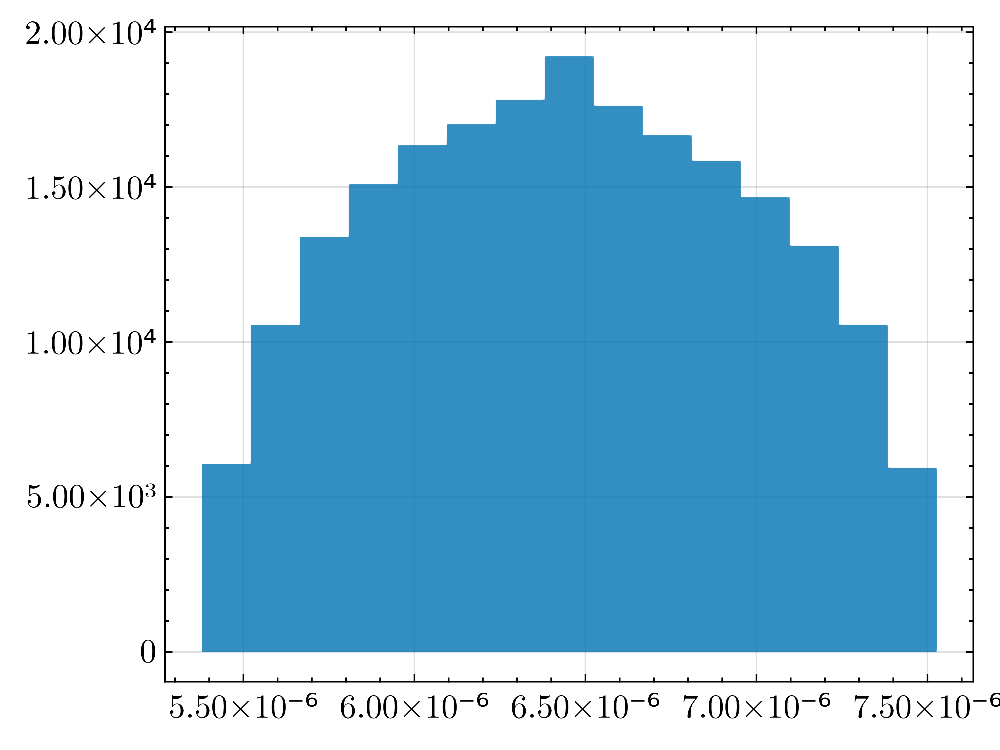

In [23]:
hist(all_stars.xi .- all_stars.xi_0)

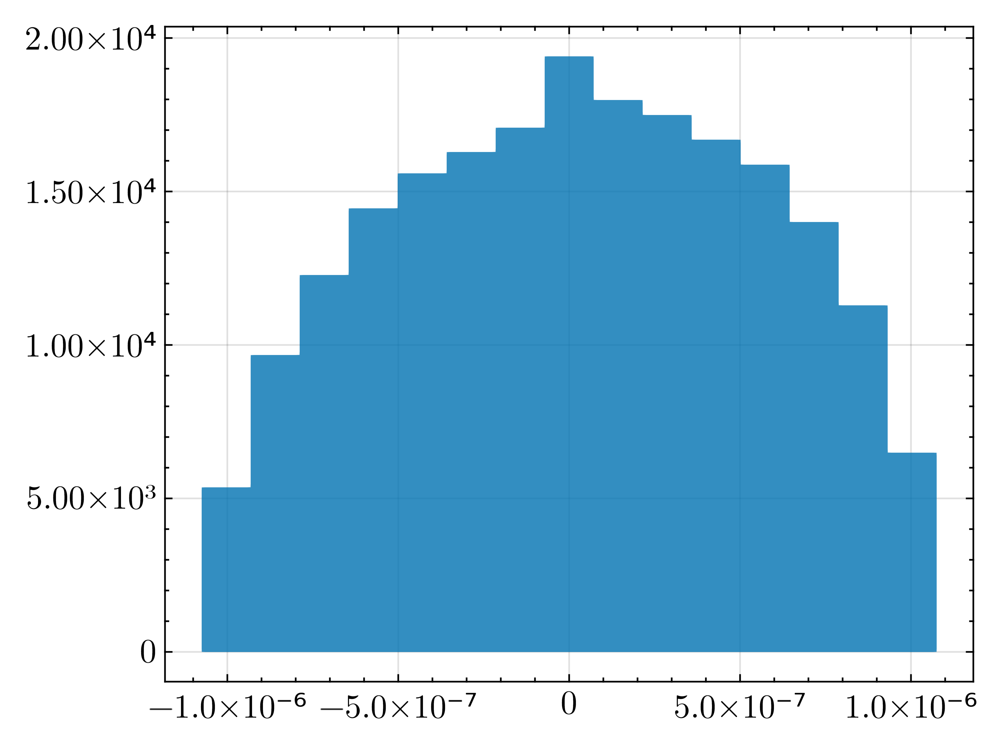

In [24]:
hist(all_stars.eta .- all_stars.eta_0)

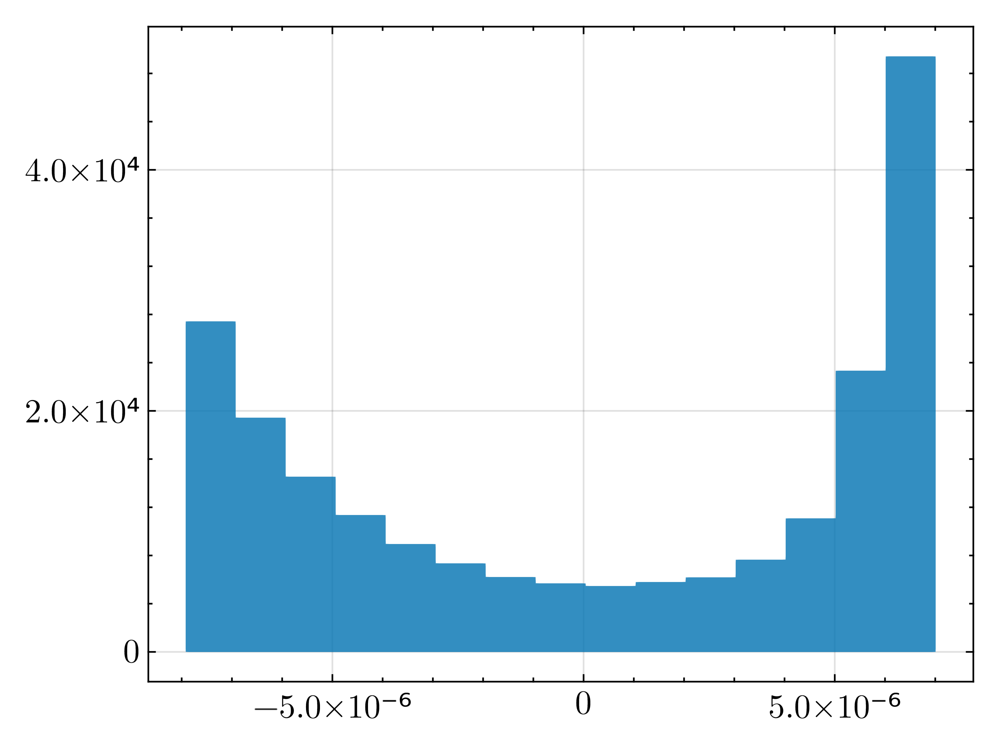

In [25]:
hist(all_stars.r_ell .- all_stars.r_ell_0 * sqrt(params["a"]*params["b"]))

# Member plots

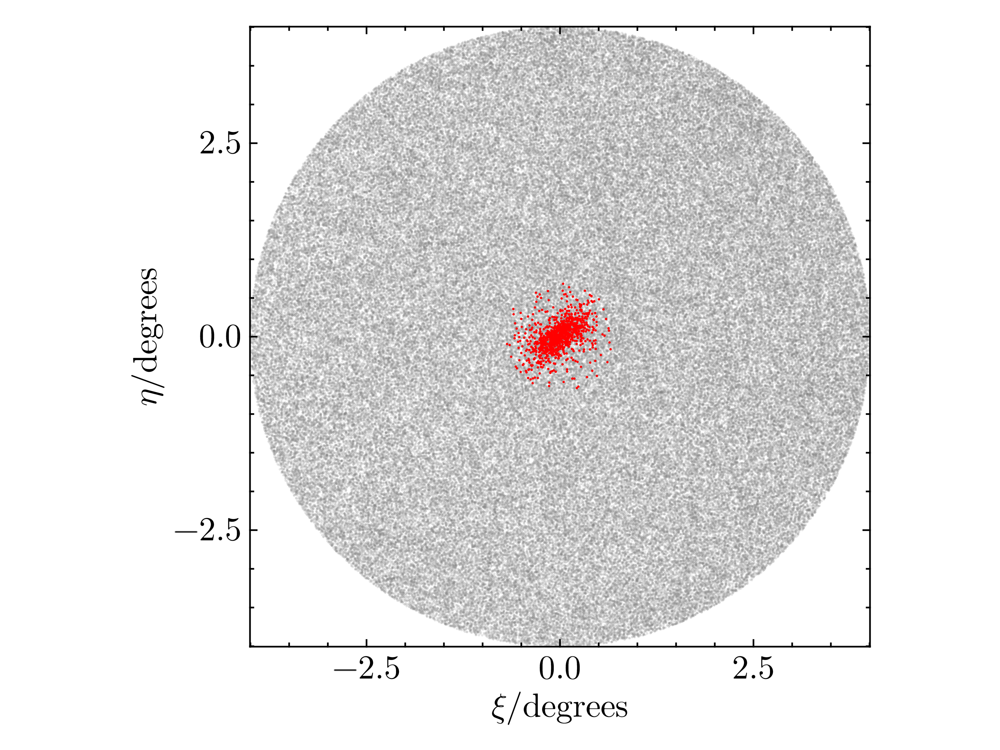

In [26]:
fig, ax, p = plot_all_tangent(all_stars, markersize=2,
        color=(:grey, 0.2))
plot_all_tangent!(ax, members, markersize=2, color=(:red))

ax.xgridvisible = false
ax.ygridvisible = false
fig

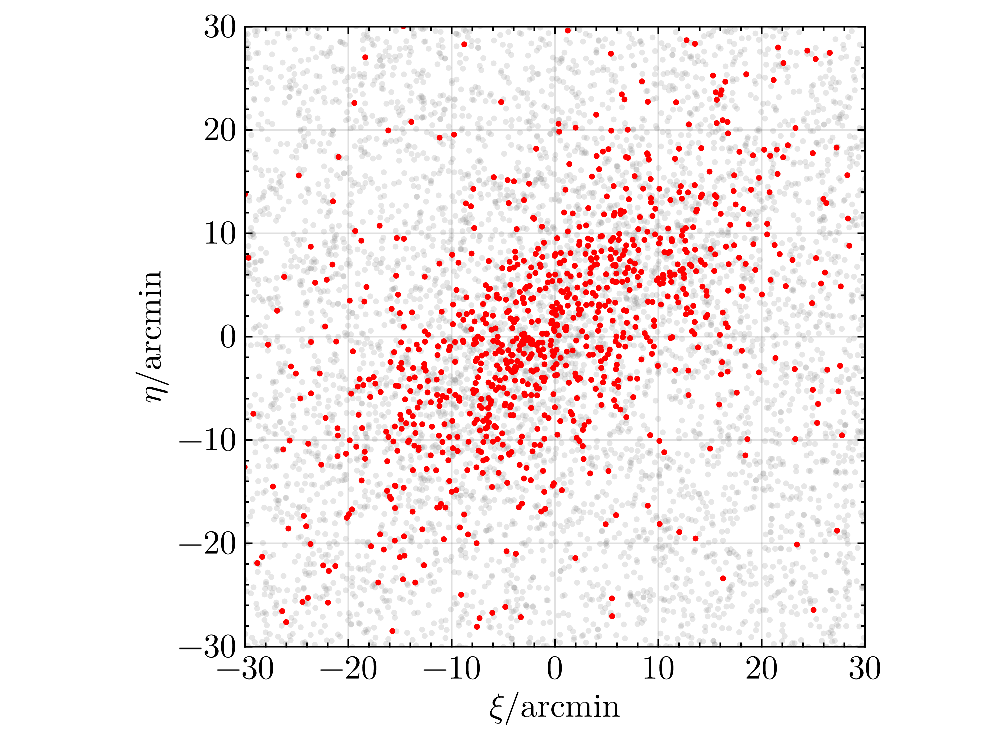

In [27]:
fig, ax, p = plot_all_tangent(all_stars, markersize=5,
        color=(:grey, 0.2), r_max=30, scale=60, units="arcmin")
plot_all_tangent!(ax, members, scale=60, markersize=5, color=:red)
fig

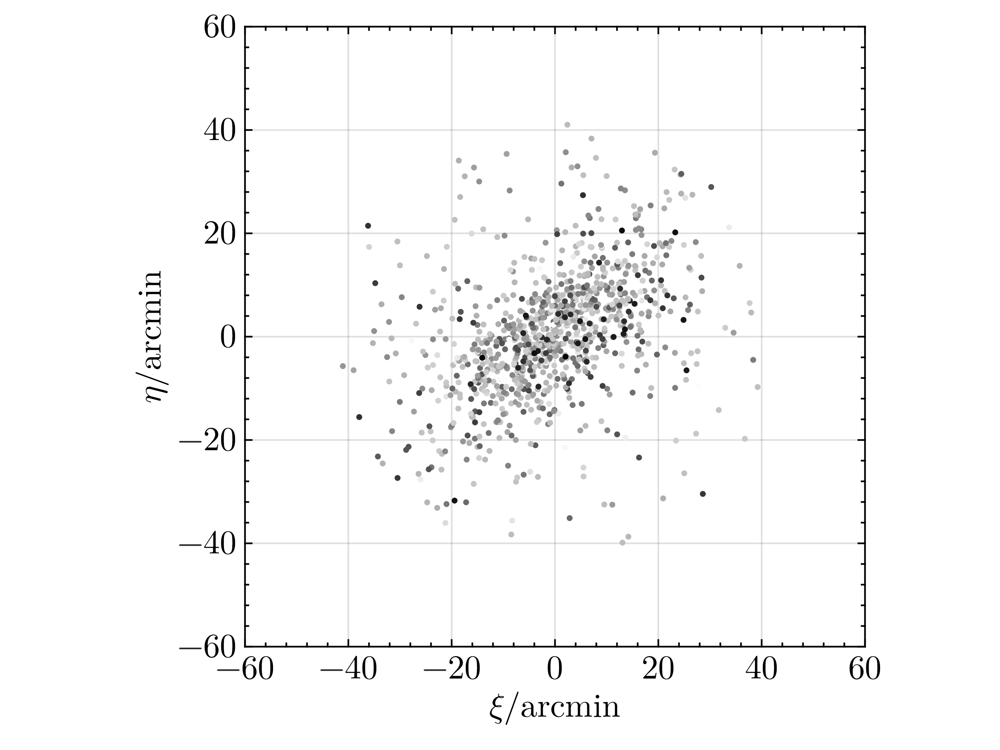

In [28]:

f = Figure()
da = 60
ax = Axis(f[1, 1], 
    xlabel=L"\xi / \textrm{arcmin} ", ylabel=L"\eta / \textrm{arcmin}",
    aspect=1,
    limits = (-da, da, -da, da))

scatter!(ax, 
    60*members.xi, 60*members.eta, 
    color=members.phot_g_mean_mag, 
    colormap=:greys,
    markersize=5
)


f

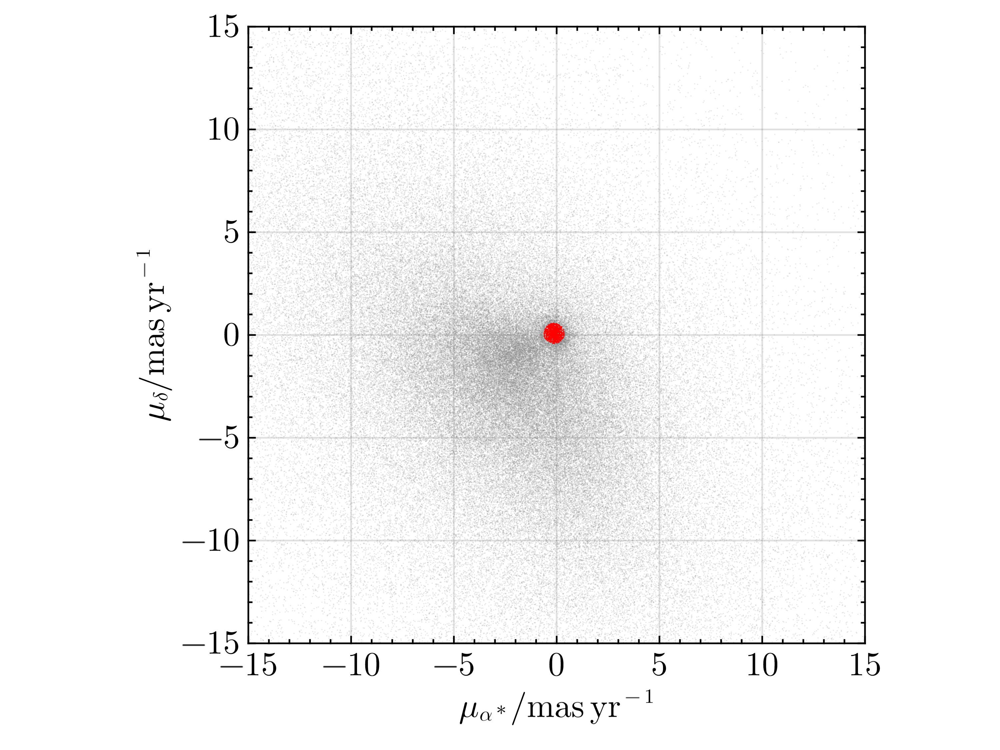

In [29]:
fig = Figure()
da = 15
ax = Axis(fig[1, 1], limits=(-da, da, -da, da), aspect=1,
    xlabel=L"\mu_{\alpha *} / \mathrm{ mas\, yr^{-1}}", 
    ylabel=L"\mu_\delta / \mathrm{ mas\, yr^{-1}}")
scatter!(ax, all_stars.pmra, all_stars.pmdec, 
    color=(:grey, 0.2), markersize=1)

scatter!(ax, members.pmra, members.pmdec, 
    color=(:red, 1), markersize=1)
fig

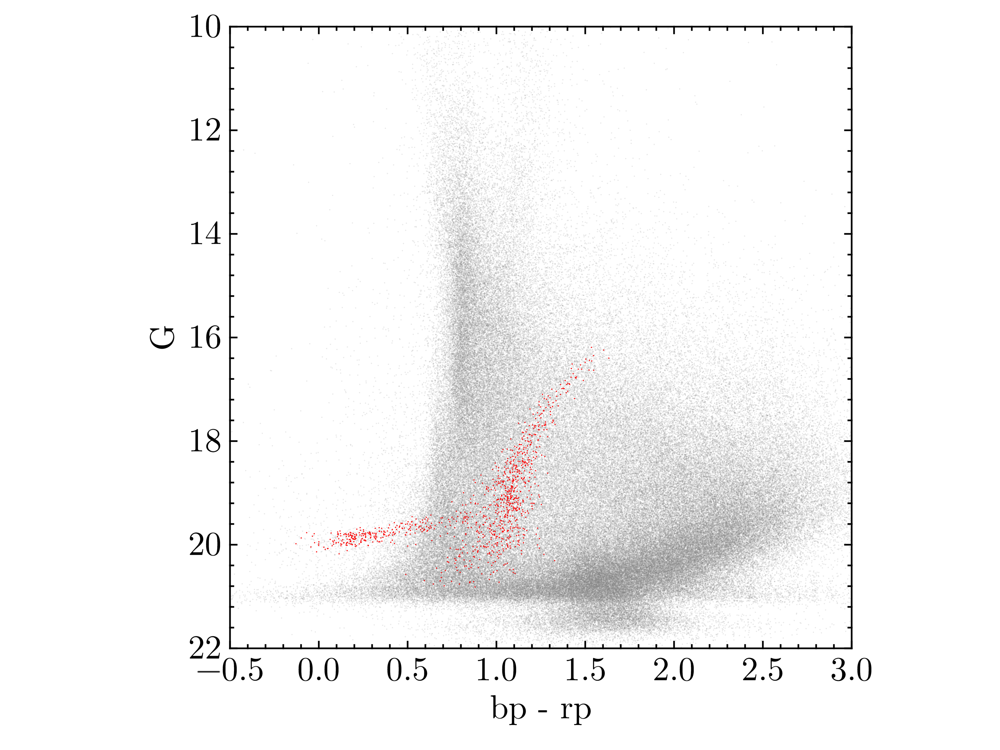

In [30]:
fig = Figure()
ax = Axis(fig[1, 1], aspect=1,
    limits=(-0.5, 3, 10, 22), yreversed=true,
    xlabel="bp - rp", 
    ylabel="G",)
scatter!(ax, all_stars.bp_rp, all_stars.phot_g_mean_mag, 
    color=(:grey, 0.2), markersize=1)

scatter!(ax, members.bp_rp, members.phot_g_mean_mag, 
    color=(:red, 1), markersize=1)

ax.xgridvisible = false
ax.ygridvisible = false

fig

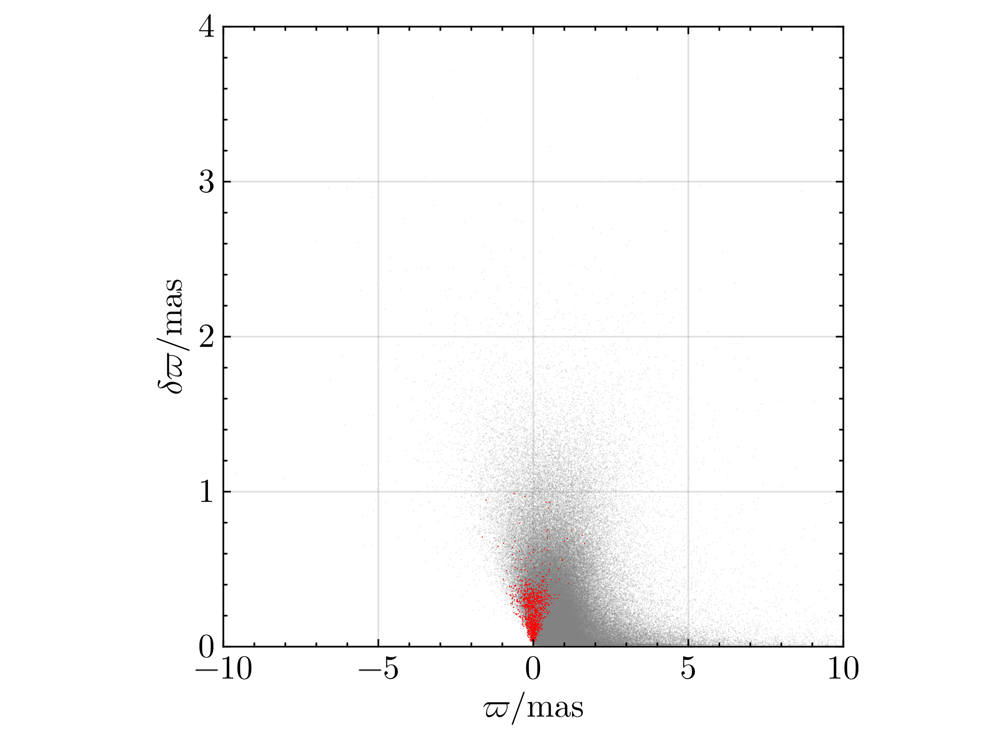

In [31]:
fig = Figure()
da = 15
ax = Axis(fig[1, 1], aspect=1, limits=(-10, 10, 0, 4),
    xlabel=L"\varpi / \mathrm{ mas }", 
    ylabel=L"\delta\varpi / \mathrm{ mas }")
scatter!(ax, all_stars.parallax, all_stars.parallax_error, 
    color=(:grey, 0.2), markersize=1)

scatter!(ax, members.parallax, members.parallax_error, 
    color=(:red, 1), markersize=1)
fig

# Calculating density profiles

In [32]:
P08 = CSV.read("first_apo.csv", DataFrame)
P08_no_tides = CSV.read("no_tides.csv", DataFrame);

LoadError: ArgumentError: "first_apo.csv" is not a valid file or doesn't exist

## Functions

In [33]:
function running_hist(xs, bw, normalize=false)
	N = length(xs)
	hist = zeros(N)

	x_sort = sort(xs)
	for i in 1:N
		x0 = x_sort[i]
		count = sum(x0 + bw .> x_sort .> x0 - bw)
		hist[i] = count
	end

	if normalize
		dx = lguys.gradient(x_sort)
		area = sum(hist .* dx)
		hist ./= area
	end
	return x_sort, hist
end

running_hist (generic function with 2 methods)

In [34]:
function norm_hist(xs, bw)
	bins = collect(minimum(xs):bw:(maximum(xs) + bw))
	x_h, y_h = lguys.calc_histogram(xs, bins)
    y_e = sqrt.(y_h)
    
	area = length(xs)

	return x_h, y_h ./ area, y_e ./ area
end

norm_hist (generic function with 1 method)

In [35]:
function calc_Σ(log_r, hist)
	r = 10 .^ log_r
	Σ = hist ./ (2π * log(10) * r .^ 2) # is equivalent because of derivative of log r
	return Σ
end

calc_Σ (generic function with 1 method)

In [36]:
function calc_Σ_mean(log_r, hist)
	r = 10 .^ lguys.midpoint(log_r)
	counts = cumsum(hist .* diff(log_r))
	Areas = @. π * r^2
	σ = counts ./ Areas
	return σ
end

calc_Σ_mean (generic function with 1 method)

In [37]:
function calc_Γ(log_rs, ρs, step=1)
	dx = lguys.gradient(log_rs)
	dρ = lguys.gradient(log10.(ρs))

	return dρ ./ dx #lguys.gradient(log10.(ρs), log_rs)
end

calc_Γ (generic function with 2 methods)

In [38]:
function log_Σ_exp(r, A, r_s)
    return @. A + 1/log(10) * (-r / r_s)
end

log_Σ_exp (generic function with 1 method)

In [39]:
function calc_properties(rs, bw=0.1)
    log_r_bin, counts, δ_counts = norm_hist(log10.(rs), 0.1)
    counts = counts .± δ_counts
    log_r = lguys.midpoint(log_r_bin)
    δ_log_r = diff(log_r_bin) ./ 2
    log_r = log_r .± δ_log_r
    r_bin = 10 .^ log_r_bin

    r = 10 .^ log_r

    As = π * diff((10 .^ log_r_bin) .^ 2)
    Σ = counts ./ As 
    # Σ_e = @. y_e / ys * Σ
    #Σ_m = calc_Σ_mean(xs, ys)

    M_in = cumsum(counts)
    A_in = @. π * (r_bin[2:end])^2
    Σ_m = M_in ./ A_in

    Γ = calc_Γ(log_r, Σ)
    Γ_max = @. 2*(1 - Σ / Σ_m)
    
    return (log_r=log_r, log_r_bins=log_r_bin, counts=counts, Σ=Σ, Σ_m=Σ_m, Γ=Γ, Γ_max=Γ_max, M_in=M_in)
end

calc_properties (generic function with 2 methods)

In [40]:
function fit_profile(obs; r_max=Inf, N=10_000)
    r_val = [10 ^ r.val for r in obs.log_r]
    log_Σ = log10.(obs.Σ)
    filt = r_val .< r_max
    filt .&= map(x->isfinite(x), log_Σ)
    filt .&= @. !isnan(log_Σ)
    
    r_val = r_val[filt]
    log_Σ = log_Σ[filt]
    
    print(log_Σ)

    log_Σ_val = [s.val for s in log_Σ]
    log_Σ_e = [s.err for s in log_Σ]

    popt, covt = SciPy.optimize.curve_fit(log_Σ_exp, r_val, log_Σ_val, 
        sigma=log_Σ_e, p0=[1, 0.1])
    
    popt_p = popt .± sqrt.(diag(covt))
    println("log_Σ_0 = $(popt_p[1])")
    println("r_s = $(popt_p[2])")
    props = predict_properties(r->10 .^ log_Σ_exp(r, popt...), 
        N=N, log_r_min=obs.log_r_bins[1], log_r_max=obs.log_r_bins[end])
    
    log_Σ_pred = log_Σ_exp.(10 .^ value.(obs.log_r), popt...)
    log_Σ_res = log10.(obs.Σ) .- log_Σ_pred
    return popt_p, props, log_Σ_res
end

fit_profile (generic function with 1 method)

In [41]:
function predict_properties(Σ_model; N=10_000, log_r_min=-2, log_r_max=2)
    log_r_bins = LinRange(log_r_min, log_r_max, 1000)
    log_r = lguys.midpoint(log_r_bins)
    r = 10 .^  log_r
    r_bins = 10 .^ log_r_bins
    
    Σ = Σ_model.(r)
    Γ = calc_Γ(log_r, Σ)
    M_in = [quadgk(rrr->2π*rrr*Σ_model(rrr), 0, rr)[1] for rr in r]
    Σ_m = M_in ./ (π * r .^ 2)
    Γ_max = 2*(1 .- Σ ./ Σ_m)
    counts =  Σ .* (2π *  r .* diff(r_bins) )
    
    return (log_r=log_r, log_r_bins=log_r_bins, counts=counts, Σ=Σ, Σ_m=Σ_m, Γ=Γ, Γ_max=Γ_max, M_in=M_in)

end

predict_properties (generic function with 1 method)

In [42]:
"""
    normalize_histogram(bins, counts)

Normalizes a histogram such that the area is equal to 1, return the bin midpoints
and the normalized (pdf) of the counts
"""
function normalize_histogram(bins, counts)
    A = sum(counts .* diff(bins))
    
    return lguys.midpoint(bins), counts ./ A
end

normalize_histogram

In [43]:
function plot_rh!()
    vline!([log10.(r_h)], color="grey", s=:dash, z_order=1, label=L"r_h")
end

plot_rh! (generic function with 1 method)

In [44]:
function plot_Σ_fit_res(obs, pred, res)
    fig = Figure()
    ax = Axis(fig[1, 1], 
        ylabel=L"\log \Sigma\ \mathrm{(stars/arcmin^2)}")
    N = length(obs.log_r)
    y = log10.(obs.Σ .* N)
    errorbars!(ax, value.(obs.log_r), value.(y), err.(y))
    scatter!(ax, value.(obs.log_r), value.(y))

    lines!(ax, pred.log_r, log10.(pred.Σ .* N), color=:red)
    
    
    ax2 = Axis(fig[2, 1],
        ylabel=L"\delta\log\Sigma",
    xlabel=log_r_label)

#     p2 = plot(ylabel=L"\Delta \log\Sigma", xlabel=log_r_label, ylim=(-2, 2))

    scatter!(ax2, value.(obs.log_r), -value.(res), err.(res), msw=1, msc=1, label="")

    hlines!(0, color=:black)
    
    rowsize!(fig.layout, 2, Relative(1/4))

    linkxaxes!(ax, ax2)
    hidexdecorations!(ax, grid=false)
#     return plot(p1, p2, layout=grid(2, 1, heights=(0.8, 0.2)), link=:x, bottom_margin=[-5Plots.mm 0Plots.mm])
    return fig
end

plot_Σ_fit_res (generic function with 1 method)

## plots

In [45]:
log_r_label = L"\log r / \mathrm{arcmin}"

L"$\log r / \mathrm{arcmin}$"

In [46]:
r = 60 * members.r_ell # arcminutes
obs = calc_properties(r);

In [47]:
println(maximum(r))

321.1486225997367


In [48]:
println(maximum(r) / 60)

5.352477043328945


In [49]:
maximum(sqrt.(all_stars.xi .^ 2 + all_stars.eta .^ 2))

4.006486267067345

In [50]:
maximum(all_stars.r_ell)

5.971466293704043

In [51]:
4 / sqrt(1 - params["ecc"])

5.962847939999439

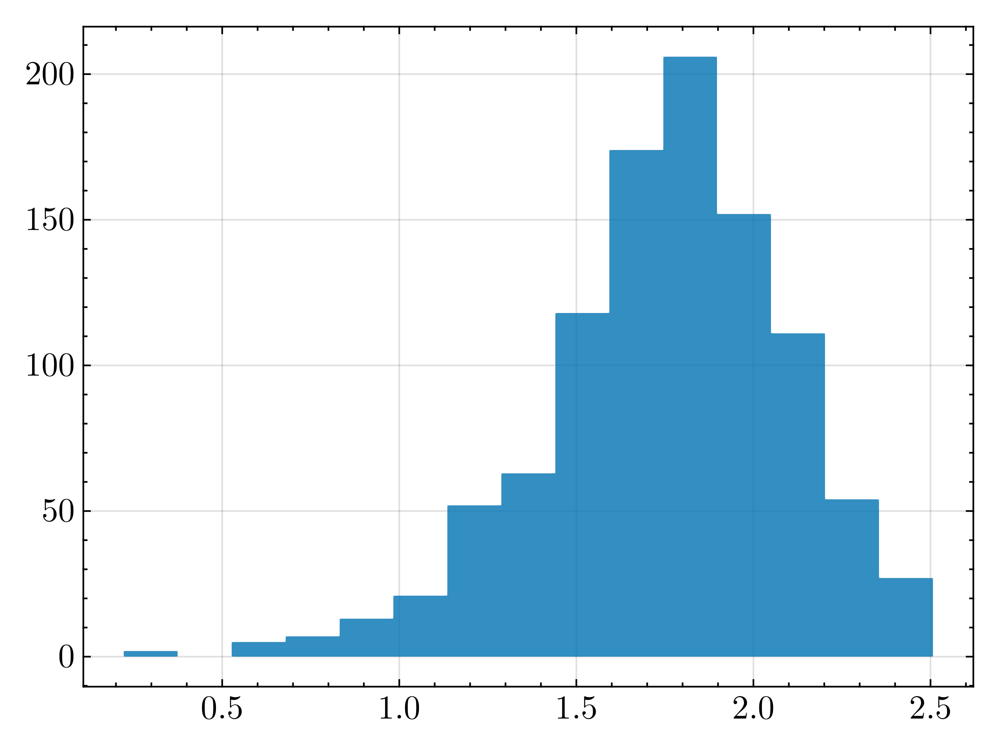

In [52]:
hist(log10.(r))

In [53]:
popt, pred, res = fit_profile(obs);

Measurement{Float64}[-3.41 ± 0.31, -4.01 ± 0.31, -3.73 ± 0.18, -4.11 ± 0.22, -3.96 ± 0.14, -4.27 ± 0.16, -4.06 ± 0.1, -4.096 ± 0.085, -4.098 ± 0.068, -4.342 ± 0.071, -4.311 ± 0.055, -4.352 ± 0.046, -4.432 ± 0.04, -4.543 ± 0.036, -4.854 ± 0.041, -5.085 ± 0.042, -5.381 ± 0.047, -5.763 ± 0.058, -6.142 ± 0.071, -6.568 ± 0.093, -7.03 ± 0.13]log_Σ_0 = -3.939 ± 0.032
r_s = 37.4 ± 1.1


In [54]:
dist = params["dist"] ± params["dist_err"]

76.0 ± 10.0

In [55]:
popt[2]  * 60 / (206265) * dist * 1e3 # scale radius in pc

830.0 ± 110.0

In [56]:
popt[2] * 1.6783 # half light radius

62.8 ± 1.9

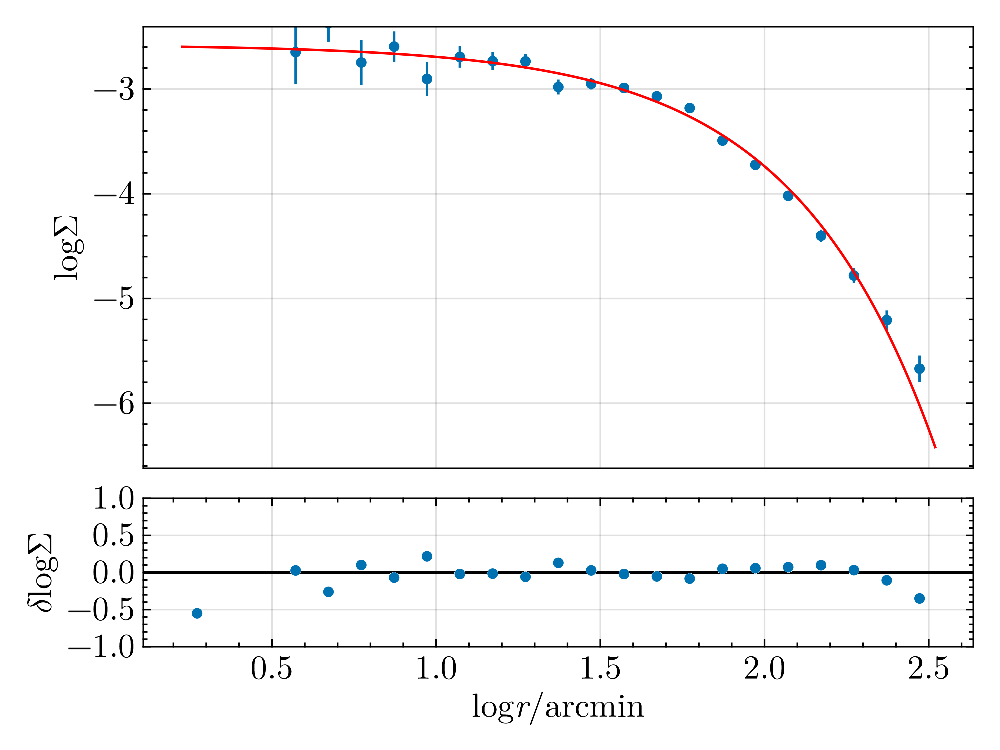

In [57]:
plot_Σ_fit_res(obs, pred, res)

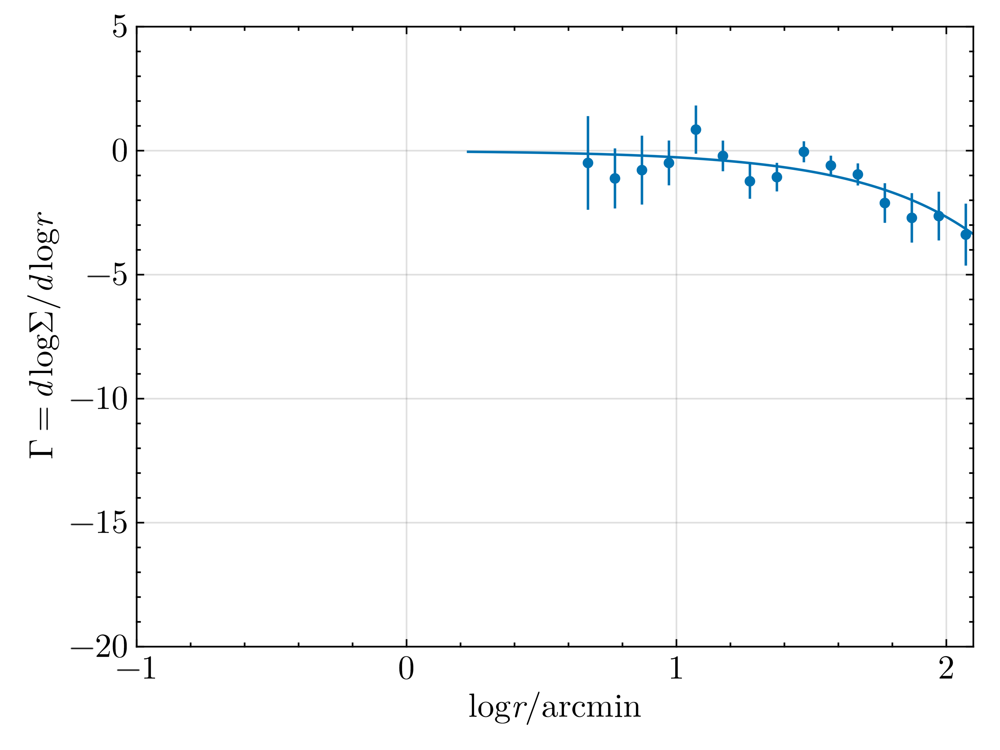

In [58]:
fig = Figure()
ax = Axis(fig[1, 1], limits=(-1, 2.1, -20, 5))
scatter!(value.(obs.log_r), value.(obs.Γ),)
errorbars!(value.(obs.log_r), value.(obs.Γ), err.(obs.Γ) )

lines!(pred.log_r, pred.Γ, label="exponential")

ax.xlabel = log_r_label
ax.ylabel = L"\Gamma = d\,\log \Sigma / d\,\log r"

fig

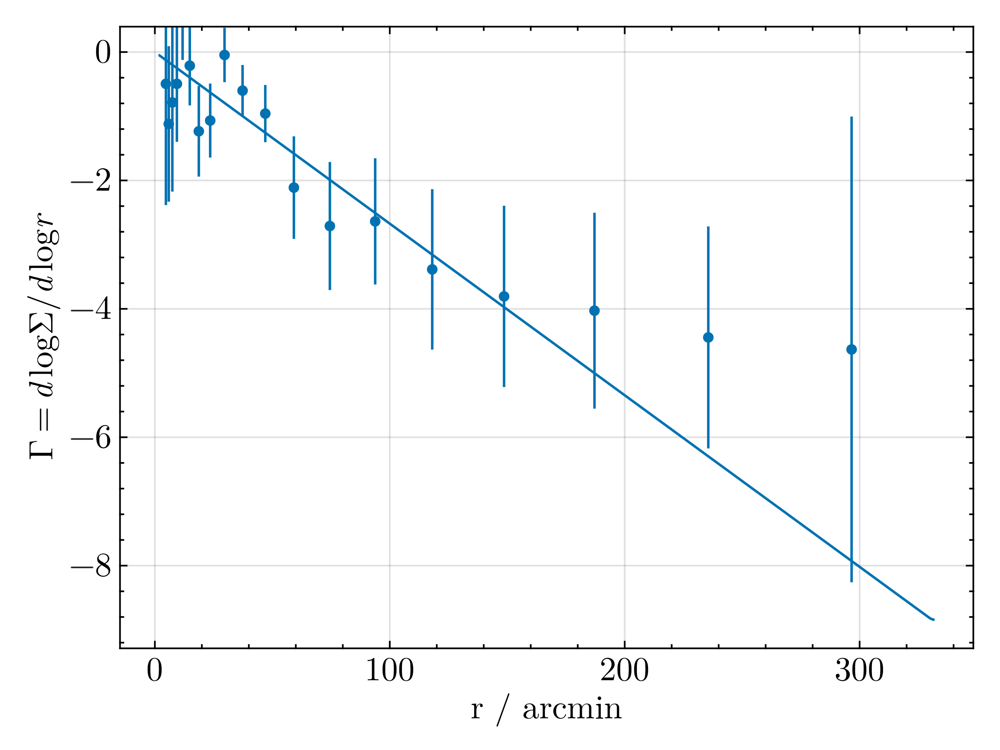

In [59]:
fig = Figure()
ax = Axis(fig[1, 1])
scatter!(10 .^ value.(obs.log_r), value.(obs.Γ),)
errorbars!(10 .^ value.(obs.log_r), value.(obs.Γ), err.(obs.Γ) )

lines!(10 .^ pred.log_r, pred.Γ, label="exponential")

ax.xlabel = "r / arcmin"
ax.ylabel = L"\Gamma = d\,\log \Sigma / d\,\log r"

fig

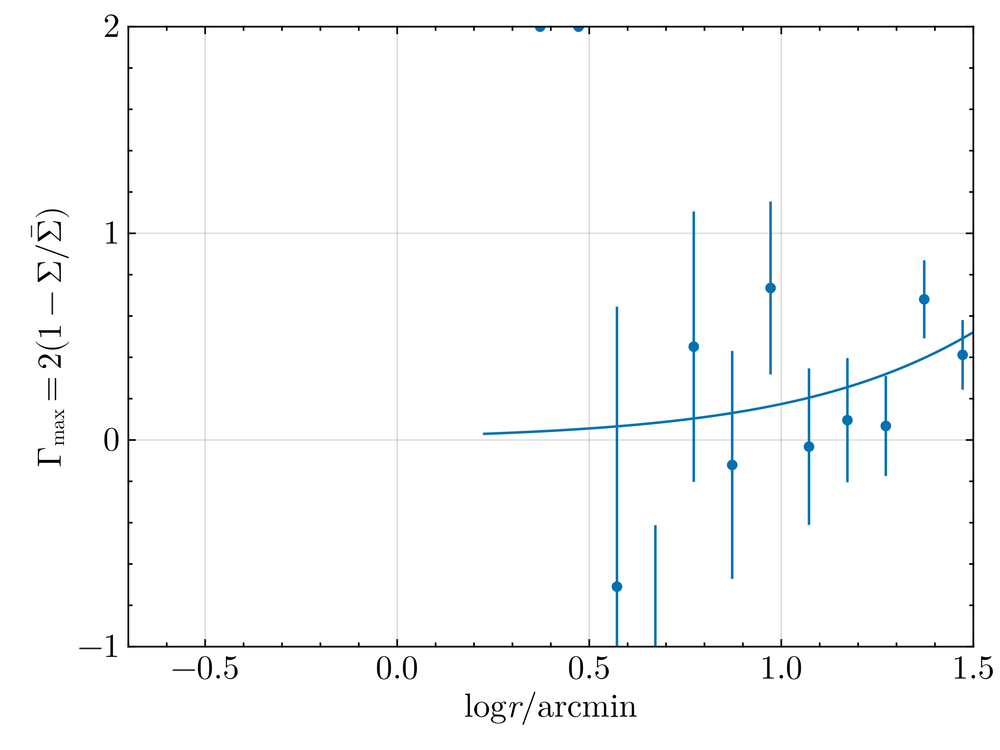

In [60]:
fig = Figure()
ax = Axis(fig[1, 1], limits=(-0.7, 1.5, -1, 2))
scatter!(value.(obs.log_r), value.(obs.Γ_max),)
errorbars!(value.(obs.log_r), value.(obs.Γ_max), err.(obs.Γ_max) )

lines!(pred.log_r, pred.Γ_max, label="exponential")

ax.xlabel = log_r_label
ax.ylabel = L"\Gamma_\mathrm{max} = 2(1 - \Sigma / \bar{\Sigma})"

fig

## Saving results

In [61]:
data = Dict{String, Any}()

data["log_r"] = value.(obs.log_r)
data["Sigma"] = value.(obs.Σ)
data["Sigma_err"] = err.(obs.Σ)
data["Gamma"] = value.(obs.Γ)
data["Gamma_err"] = err.(obs.Γ)
data["log_Sigma_0"] = popt[1].val
data["log_Sigma_0_err"] = popt[1].err
data["r_s"] = popt[2].val
data["r_s_err"] = popt[2].err

;

In [64]:
open(outname, "w") do f
    s = json(data)
    write(f, s)
end

2303